In [246]:
import streamlit as st
from pomme.carto_resultats import filtre_geo, filtre_election, filtre_annee, filtre_tour, process_results
import pandas as pd
import geopandas as gpd
from streamlit_folium import st_folium, folium_static
import folium 
import time
import json

In [233]:
results

,Unnamed: 0,Tour,Code du département,Code de la commune,Libellé de la commune,Code du b.vote,Inscrits,Votants,Exprimés,N°Panneau,...,Heure de fermeture,Code Postal,Ville,Nom Bureau Vote,Adresse,Adresse Substitution,Coordonnées,Département,uniq_bdv,id_bv
0,814746,1,94,1,Ablon-sur-Seine,1.0,1125.0,693.0,682.0,12.0,...,20.0,94480.0,Ablon-sur-Seine,Centre Culturel 'Espace Alain Poher',7 avenue Auguste Duru,7 avenue Auguste Duru,"48.724181, 2.420302",94,Centre Culturel 'Espace Alain Poher' - Ablon-...,94001_1
1,814747,1,94,1,Ablon-sur-Seine,1.0,1125.0,693.0,682.0,13.0,...,20.0,94480.0,Ablon-sur-Seine,Centre Culturel 'Espace Alain Poher',7 avenue Auguste Duru,7 avenue Auguste Duru,"48.724181, 2.420302",94,Centre Culturel 'Espace Alain Poher' - Ablon-...,94001_1
2,814748,1,94,1,Ablon-sur-Seine,1.0,1125.0,693.0,682.0,46.0,...,20.0,94480.0,Ablon-sur-Seine,Centre Culturel 'Espace Alain Poher',7 avenue Auguste Duru,7 avenue Auguste Duru,"48.724181, 2.420302",94,Centre Culturel 'Espace Alain Poher' - Ablon-...,94001_1
3,814749,1,94,1,Ablon-sur-Seine,1.0,1125.0,693.0,682.0,48.0,...,20.0,94480.0,Ablon-sur-Seine,Centre Culturel 'Espace Alain Poher',7 avenue Auguste Duru,7 avenue Auguste Duru,"48.724181, 2.420302",94,Centre Culturel 'Espace Alain Poher' - Ablon-...,94001_1
4,814750,1,94,1,Ablon-sur-Seine,1.0,1125.0,693.0,682.0,60.0,...,20.0,94480.0,Ablon-sur-Seine,Centre Culturel 'Espace Alain Poher',7 avenue Auguste Duru,7 avenue Auguste Duru,"48.724181, 2.420302",94,Centre Culturel 'Espace Alain Poher' - Ablon-...,94001_1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
87225,7141519,2,94,81,Vitry-sur-Seine,53.0,966.0,604.0,546.0,NaN,...,20.0,94400.0,Vitry-sur-Seine,Foyer Paul et Noémie Froment,64 rue Louise Aglaé Cretté,64 rue Louise Aglaé Cretté,"48.797006, 2.393669",94,Foyer Paul et Noémie Froment - Vitry-sur-Seine,94081_53
87226,7141520,2,94,81,Vitry-sur-Seine,54.0,911.0,627.0,575.0,NaN,...,20.0,94400.0,Vitry-sur-Seine,Ecole élémentaire Montesquieu,20/22 avenue Anatole France,20/22 avenue Anatole France,"48.802215, 2.403386",94,Ecole élémentaire Montesquieu - Vitry-sur-Seine,94081_54
87227,7141521,2,94,81,Vitry-sur-Seine,55.0,910.0,615.0,548.0,NaN,...,20.0,94400.0,Vitry-sur-Seine,Ecole élémentaire Montesquieu,20/22 avenue Anatole France,20/22 avenue Anatole France,"48.802215, 2.403386",94,Ecole élémentaire Montesquieu - Vitry-sur-Seine,94081_55
87228,7141522,2,94,81,Vitry-sur-Seine,56.0,982.0,632.0,578.0,NaN,...,20.0,94400.0,Vitry-sur-Seine,Ecole maternelle Eva Salmon - Préau,60 rue Charles Fourier,60 rue Charles Fourier,"48.802578, 2.40619",94,Ecole maternelle Eva Salmon - Préau - Vitry-s...,94081_56


In [235]:
#Load dictionary with paths for carto and results
with open("../db/carto/departement_fichiers_carto.json") as f:
    departements_fichiers_carto=json.load(f)
with open("../db/results/departement_fichiers.json") as f:
    departements_fichiers_results=json.load(f)
with open("../db/results/villes_par_dep.json") as f:
    villes_par_dep=json.load(f)

In [237]:
ville = villes_par_dep['94']

In [251]:
ville='Vincennes'

In [239]:
gdf, results = load_data("94")

loading results


/var/folders/rc/0g2xxgc57fq40kc5jwsm7h_c0000gn/T/ipykernel_51491/2742416144.py:11: DtypeWarning: Columns (18,19,21,22,24,25,27,28,29,30,31,32) have mixed types. Specify dtype option on import or set low_memory=False.
  results = pd.read_csv(f'../db/results/{departements_fichiers_results[dep]}')


results loaded in 1.4152801036834717 seconds


In [253]:
params= {
    "filtre_geo_cat" : "ville",
    "filtre_geo_val" : ville,
    "filtre_election_val" : "pres",
    "filtre_annee_val" : 2022,
    "filtre_tour_val" : 1, 
    "Nuance": "CENTRE-DROIT"}

In [249]:
results[results["Libellé de la commune"]==ville]

ValueError: ('Lengths must match to compare', (87230,), (57,))

In [ ]:

def filtre_geo(df:pd.DataFrame, cat_filtre : str, valeur_filtre : str) -> pd.DataFrame : 
    """_summary_

    Args:
        df (pd.DataFrame): dataframe avec une colonne Code Postal 
        cat_filtre (str): peut prendre la valeur "dep" ou "ville"
        valeur_filtre (str): si cat_filtre = "dep" : valeur_filtre prend le code du département (ex : 75); si cat_filtre = "ville" : valeur_filtre prend le code postal de la ville (ex : 75001)

    Returns:
        pd.DataFrame: dataframe filtré
    """
    if cat_filtre == "dep":
        return df[df["Code du département"]==int(valeur_filtre)]
    elif cat_filtre == "ville":
        return df[df["Libellé de la commune"]==valeur_filtre]

In [248]:
tmp_results = filtre_geo(results, params["filtre_geo_cat"], params["filtre_geo_val"])
# tmp_results = filtre_election(tmp_results, params["filtre_election_val"])
# tmp_results = filtre_annee(tmp_results, params["filtre_annee_val"])
# tmp_results = filtre_tour(tmp_results, params["filtre_tour_val"])


ValueError: ('Lengths must match to compare', (87230,), (57,))

In [254]:
tmp_to_plot = process_results(params, results, gdf)

In [255]:
tmp_to_plot

,geometry,Unnamed: 0,Tour,Code du département,Code de la commune,Libellé de la commune,Code du b.vote,Inscrits,Votants,Exprimés,...,Adresse,Adresse Substitution,Coordonnées,Département,uniq_bdv,id_bv,Nuance,Voix_nuance,% Voix/Exp_nuance,% Voix/Ins_nuance


In [ ]:
params= {
    "filtre_geo_cat" : "ville",
    "filtre_geo_val" : ville,
    "filtre_election_val" : "pres",
    "filtre_annee_val" : 2022,
    "filtre_tour_val" : 1, 
    "Nuance": "CENTRE-DROIT"}

In [226]:
def load_data(dep : str):
    """Charge les données"""

    # Lire le fichier GeoJSON
    gdf = gpd.read_file(f"../db/carto/{departements_fichiers_carto[dep]}")

    #Lire le fichier résultats des élections 
    print("loading results")
    #time it
    start = time.time()
    results = pd.read_csv(f'../db/results/{departements_fichiers_results[dep]}')
    end = time.time()
    print("results loaded in", end-start, "seconds")

    return gdf, results


In [227]:
with open("../db/carto/departement_fichiers_carto.json") as f:
    departements_fichiers_carto=json.load(f)
with open("../db/results/departement_fichiers.json") as f:
    departements_fichiers_results=json.load(f)

In [ ]:
def extract_villes(results: pd.DataFrame, dep: str):
    """Extrait les villes du département"""
    villes = list(results[results["dep"] == dep]["ville"].unique())
    return villes

In [232]:
results[results['Code du département'] == 94]['Libellé de la commune'].unique() 

array(['Ablon-sur-Seine', 'Alfortville', 'Arcueil', 'Boissy-Saint-Léger',
       'Bonneuil-sur-Marne', 'Bry-sur-Marne', 'Cachan',
       'Champigny-sur-Marne', 'Charenton-le-Pont',
       'Chennevières-sur-Marne', 'Chevilly-Larue', 'Choisy-le-Roi',
       'Créteil', 'Fontenay-sous-Bois', 'Fresnes', 'Gentilly',
       "L'Hay-les-Roses", 'Ivry-sur-Seine', 'Joinville-le-Pont',
       'Le Kremlin-Bicêtre', 'Limeil-Brévannes', 'Maisons-Alfort',
       'Mandres-les-Roses', 'Marolles-en-Brie', 'Nogent-sur-Marne',
       'Noiseau', 'Orly', 'Ormesson-sur-Marne', 'Périgny',
       'Le Perreux-sur-Marne', 'Le Plessis-Trévise', 'La Queue-en-Brie',
       'Rungis', 'Saint-Mandé', 'Saint-Maur-des-Fossés', 'Saint-Maurice',
       'Santeny', 'Sucy-en-Brie', 'Thiais', 'Valenton', 'Villecresnes',
       'Villejuif', 'Villeneuve-le-Roi', 'Villeneuve-Saint-Georges',
       'Villiers-sur-Marne', 'Vincennes', 'Vitry-sur-Seine',
       'Périgny-sur-Yerres', 'Boissy-Saint-L\x8eger',
       'Chennevi\x8fres-su

In [228]:
gdf, results = load_data("94")

loading results
results loaded in 2.111158847808838 seconds


/var/folders/rc/0g2xxgc57fq40kc5jwsm7h_c0000gn/T/ipykernel_51491/2742416144.py:11: DtypeWarning: Columns (18,19,21,22,24,25,27,28,29,30,31,32) have mixed types. Specify dtype option on import or set low_memory=False.
  results = pd.read_csv(f'../db/results/{departements_fichiers_results[dep]}')


In [188]:
## read geojson file
# Chemin vers le fichier GeoJSON
file_path = "../db/carto/contours-france-entiere-94.geojson"
# Lire le fichier GeoJSON
gdf = gpd.read_file(file_path)
#Lire le fichier résultats des élections 
results = pd.read_csv('../db/results/all_results.csv')


/var/folders/rc/0g2xxgc57fq40kc5jwsm7h_c0000gn/T/ipykernel_51491/1027702903.py:7: DtypeWarning: Columns (10,11,12,18,19,21,22,24,25,27,28,29,30,31,32) have mixed types. Specify dtype option on import or set low_memory=False.
  results = pd.read_csv('../db/results/all_results.csv')


In [203]:
with open("../db/carto/departement_fichiers_carto.json") as f:
    departements_fichiers_carto=json.load(f)
with open("../db/results/departement_fichiers.json") as f:
    departements_fichiers_results=json.load(f)

In [205]:
departements_fichiers_carto

{'1': 'contours_01.csv',
 '2': 'contours_02.csv',
 '3': 'contours_03.csv',
 '4': 'contours_04.csv',
 '5': 'contours_05.csv',
 '6': 'contours_06.csv',
 '7': 'contours_07.csv',
 '8': 'contours_08.csv',
 '9': 'contours_09.csv',
 '10': 'contours_10.csv',
 '11': 'contours_11.csv',
 '12': 'contours_12.csv',
 '13': 'contours_13.csv',
 '14': 'contours_14.csv',
 '15': 'contours_15.csv',
 '16': 'contours_16.csv',
 '17': 'contours_17.csv',
 '18': 'contours_18.csv',
 '19': 'contours_19.csv',
 '21': 'contours_21.csv',
 '22': 'contours_22.csv',
 '23': 'contours_23.csv',
 '24': 'contours_24.csv',
 '25': 'contours_25.csv',
 '26': 'contours_26.csv',
 '27': 'contours_27.csv',
 '28': 'contours_28.csv',
 '29': 'contours_29.csv',
 '30': 'contours_30.csv',
 '31': 'contours_31.csv',
 '32': 'contours_32.csv',
 '33': 'contours_33.csv',
 '34': 'contours_34.csv',
 '35': 'contours_35.csv',
 '36': 'contours_36.csv',
 '37': 'contours_37.csv',
 '38': 'contours_38.csv',
 '39': 'contours_39.csv',
 '40': 'contours_40.c

In [208]:
def load_data(dep : str):
    """Charge les données"""

    # Lire le fichier GeoJSON
    
    gdf = gpd.read_file(f"../db/carto/{departements_fichiers_carto[dep]}",crs="epsg:4326")

    #Lire le fichier résultats des élections 
    print("loading results")
    #time it
    start = time.time()
    results = pd.read_csv(f'../db/results/{departements_fichiers_results[dep]}')
    end = time.time()
    print("results loaded in", end-start, "seconds")

    return gdf, results

In [210]:
results

,Unnamed: 0,Tour,Code du département,Code de la commune,Libellé de la commune,Code du b.vote,Inscrits,Votants,Exprimés,N°Panneau,...,Heure de fermeture,Code Postal,Ville,Nom Bureau Vote,Adresse,Adresse Substitution,Coordonnées,Département,uniq_bdv,id_bv
0,0,1,1,277,Nivollet-Montgriffon,1.0,63.0,42.0,40.0,42.0,...,19.0,1230.0,Nivollet-Montgriffon,Mairie de Nivollet,NaN,Mairie de Nivollet,"45.992147, 5.444118",1,Mairie de Nivollet - Nivollet-Montgriffon,01277_1
1,1,1,1,277,Nivollet-Montgriffon,1.0,63.0,42.0,40.0,43.0,...,19.0,1230.0,Nivollet-Montgriffon,Mairie de Nivollet,NaN,Mairie de Nivollet,"45.992147, 5.444118",1,Mairie de Nivollet - Nivollet-Montgriffon,01277_1
2,2,1,1,277,Nivollet-Montgriffon,1.0,63.0,42.0,40.0,46.0,...,19.0,1230.0,Nivollet-Montgriffon,Mairie de Nivollet,NaN,Mairie de Nivollet,"45.992147, 5.444118",1,Mairie de Nivollet - Nivollet-Montgriffon,01277_1
3,3,1,1,277,Nivollet-Montgriffon,1.0,63.0,42.0,40.0,47.0,...,19.0,1230.0,Nivollet-Montgriffon,Mairie de Nivollet,NaN,Mairie de Nivollet,"45.992147, 5.444118",1,Mairie de Nivollet - Nivollet-Montgriffon,01277_1
4,4,1,1,277,Nivollet-Montgriffon,2.0,49.0,33.0,33.0,7.0,...,19.0,1230.0,Nivollet-Montgriffon,Salle polyvalente de Montgriffon,NaN,Salle polyvalente de Montgriffon,"46.002213, 5.470505",1,Salle polyvalente de Montgriffon - Nivollet-M...,01277_2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6453265,7142330,2,95,680,Villiers-le-Bel,11.0,1227.0,731.0,676.0,NaN,...,20.0,95400.0,Villiers-le-Bel,École Marie Curie,45 Rue de la Republique,45 Rue de la Republique,"49.006733, 2.387895",95,École Marie Curie - Villiers-le-Bel,95680_11
6453266,7142331,2,95,680,Villiers-le-Bel,12.0,912.0,585.0,535.0,NaN,...,20.0,95400.0,Villiers-le-Bel,Groupe Scolaire Jean Jaurès,Rue Anadou Hampate BA,Rue Anadou Hampate BA,"49.001856, 2.415228",95,Groupe Scolaire Jean Jaurès - Villiers-le-Bel,95680_12
6453267,7142332,2,95,680,Villiers-le-Bel,13.0,682.0,375.0,340.0,NaN,...,20.0,95400.0,Villiers-le-Bel,École Primaire Ferdinand Buisson,Rue Jean Bullant,Rue Jean Bullant,"49.003734, 2.395569",95,École Primaire Ferdinand Buisson - Villiers-l...,95680_13
6453268,7142333,2,95,682,Villiers-le-Sec,1.0,110.0,84.0,80.0,NaN,...,20.0,95720.0,Villiers-le-Sec,Mairie annexe,6 rue de Paris,6 rue de Paris,"49.072383, 2.390203",95,Mairie annexe - Villiers-le-Sec,95682_1


In [207]:
load_data("94")

DriverError: ../../db/carto/contours_94.csv: No such file or directory

In [192]:
params = {
    "filtre_geo_cat" : "dep",
    "filtre_geo_val" : "93",
    "filtre_election_val" : "pres",
    "filtre_annee_val" : 2022,
    "filtre_tour_val" : 1, 
    "Nuance": "CENTRE-DROIT"}

tmp_to_plot = process_results(params, results, gdf)

def plot_results(tmp_to_plot, params):
    """Plot the map with the given parameters

    Args:
        tmp_to_plot (geopandas dataframe): dataframe with the results to plot
        params (dict): dictionnary with the parameters
    
    Returns:
        m (folium map): map with the results
    """
    m = tmp_to_plot[tmp_to_plot.Nuance==params['Nuance']].explore(column='% Voix/Exp_nuance', legend=True, tooltip=False,popup=['Adresse','Nom Bureau Vote','% Abs/Ins'], cmap='OrRd', tiles="CartoDB dark_matter")
    return m

In [195]:
tmp_to_plot

,geometry,Unnamed: 0,Tour,Code du département,Code de la commune,Libellé de la commune,Code du b.vote,Inscrits,Votants,Exprimés,...,Adresse,Adresse Substitution,Coordonnées,Département,uniq_bdv,id_bv,Nuance,Voix_nuance,% Voix/Exp_nuance,% Voix/Ins_nuance


In [193]:
m

NameError: name 'm' is not defined

In [194]:
tmp_to_plot[tmp_to_plot.Nuance=='CENTRE-DROIT'].explore(column='% Voix/Exp_nuance', legend=True, tooltip=False,popup=['Adresse','Nom Bureau Vote','% Abs/Ins'], cmap='OrRd', tiles="CartoDB dark_matter")

ValueError: Location values cannot contain NaNs.

In [179]:
# gdf2 = gdf[gdf.id_bv.str.startswith('94')]
# #save it as a geojson file
# gdf2.to_file("../db/carto/contours-france-entiere-latest.geojson", driver='GeoJSON')

In [120]:
results[results['Code du département']==94]

,Unnamed: 0,Tour,Code du département,Code de la commune,Libellé de la commune,Code du b.vote,Inscrits,Votants,Exprimés,N°Panneau,...,Heure de fermeture,Code Postal,Ville,Nom Bureau Vote,Adresse,Adresse Substitution,Coordonnées,Département,uniq_bdv,id_bv
729521,814746,1,94,1,Ablon-sur-Seine,1.0,1125.0,693.0,682.0,12.0,...,20.0,94480.0,Ablon-sur-Seine,Centre Culturel 'Espace Alain Poher',7 avenue Auguste Duru,7 avenue Auguste Duru,"48.724181, 2.420302",94,Centre Culturel 'Espace Alain Poher' - Ablon-...,94001_1
729522,814747,1,94,1,Ablon-sur-Seine,1.0,1125.0,693.0,682.0,13.0,...,20.0,94480.0,Ablon-sur-Seine,Centre Culturel 'Espace Alain Poher',7 avenue Auguste Duru,7 avenue Auguste Duru,"48.724181, 2.420302",94,Centre Culturel 'Espace Alain Poher' - Ablon-...,94001_1
729523,814748,1,94,1,Ablon-sur-Seine,1.0,1125.0,693.0,682.0,46.0,...,20.0,94480.0,Ablon-sur-Seine,Centre Culturel 'Espace Alain Poher',7 avenue Auguste Duru,7 avenue Auguste Duru,"48.724181, 2.420302",94,Centre Culturel 'Espace Alain Poher' - Ablon-...,94001_1
729524,814749,1,94,1,Ablon-sur-Seine,1.0,1125.0,693.0,682.0,48.0,...,20.0,94480.0,Ablon-sur-Seine,Centre Culturel 'Espace Alain Poher',7 avenue Auguste Duru,7 avenue Auguste Duru,"48.724181, 2.420302",94,Centre Culturel 'Espace Alain Poher' - Ablon-...,94001_1
729525,814750,1,94,1,Ablon-sur-Seine,1.0,1125.0,693.0,682.0,60.0,...,20.0,94480.0,Ablon-sur-Seine,Centre Culturel 'Espace Alain Poher',7 avenue Auguste Duru,7 avenue Auguste Duru,"48.724181, 2.420302",94,Centre Culturel 'Espace Alain Poher' - Ablon-...,94001_1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6452466,7141519,2,94,81,Vitry-sur-Seine,53.0,966.0,604.0,546.0,NaN,...,20.0,94400.0,Vitry-sur-Seine,Foyer Paul et Noémie Froment,64 rue Louise Aglaé Cretté,64 rue Louise Aglaé Cretté,"48.797006, 2.393669",94,Foyer Paul et Noémie Froment - Vitry-sur-Seine,94081_53
6452467,7141520,2,94,81,Vitry-sur-Seine,54.0,911.0,627.0,575.0,NaN,...,20.0,94400.0,Vitry-sur-Seine,Ecole élémentaire Montesquieu,20/22 avenue Anatole France,20/22 avenue Anatole France,"48.802215, 2.403386",94,Ecole élémentaire Montesquieu - Vitry-sur-Seine,94081_54
6452468,7141521,2,94,81,Vitry-sur-Seine,55.0,910.0,615.0,548.0,NaN,...,20.0,94400.0,Vitry-sur-Seine,Ecole élémentaire Montesquieu,20/22 avenue Anatole France,20/22 avenue Anatole France,"48.802215, 2.403386",94,Ecole élémentaire Montesquieu - Vitry-sur-Seine,94081_55
6452469,7141522,2,94,81,Vitry-sur-Seine,56.0,982.0,632.0,578.0,NaN,...,20.0,94400.0,Vitry-sur-Seine,Ecole maternelle Eva Salmon - Préau,60 rue Charles Fourier,60 rue Charles Fourier,"48.802578, 2.40619",94,Ecole maternelle Eva Salmon - Préau - Vitry-s...,94081_56


In [183]:
def filtre_geo(df:pd.DataFrame, cat_filtre : str, valeur_filtre : str) -> pd.DataFrame : 
    """_summary_

    Args:
        df (pd.DataFrame): dataframe avec une colonne Code Postal 
        cat_filtre (str): peut prendre la valeur "dep" ou "ville"
        valeur_filtre (str): si cat_filtre = "dep" : valeur_filtre prend le code du département (ex : 75); si cat_filtre = "ville" : valeur_filtre prend le code postal de la ville (ex : 75001)

    Returns:
        pd.DataFrame: dataframe filtré
    """
    if cat_filtre == "dep":
        return df[df["Code du département"]==int(valeur_filtre)]
    elif cat_filtre == "ville":
        return df[df["Code Postal"]==valeur_filtre]

def filtre_election(df : pd.DataFrame, election : str) -> pd.DataFrame:
    """
    Args:
        df (pd.DataFrame): dataframe avec une colonne Election
        election (str): peut prendre la valeur "pres" ou "leg"

    Returns:
        pd.DataFrame: dataframe filtré
    
    """
    return df[df.Election == election]

def filtre_annee(df : pd.DataFrame, annee : int) -> pd.DataFrame:
    """
    Args:
        df (pd.DataFrame): dataframe avec une colonne Election
        annee(int): peut prendre la valeur 2017 ou 2022 ou 2012

    Returns:
        pd.DataFrame: dataframe filtré
    
    """
    return df[df.Annee == annee]

def filtre_tour(df : pd.DataFrame, tour : int) -> pd.DataFrame:
    """
    Args:
        df (pd.DataFrame): dataframe avec une colonne Election
        tour(int): peut prendre la valeur 1 ou 2

    Returns:
        pd.DataFrame: dataframe filtré
    
    """
    return df[df.Tour == tour]



In [170]:
#process pour affichage des résultats 
params = {
    "filtre_geo_cat" : "dep",
    "filtre_geo_val" : "94",
    "filtre_election_val" : "pres",
    "filtre_annee_val" : 2022,
    "filtre_tour_val" : 1}




tmp_results = filtre_geo(results, params["filtre_geo_cat"], params["filtre_geo_val"])
tmp_results = filtre_election(tmp_results, params["filtre_election_val"])
tmp_results = filtre_annee(tmp_results, params["filtre_annee_val"])
tmp_results = filtre_tour(tmp_results, params["filtre_tour_val"])

tmp_to_plot = gdf[gdf['id_bv'].astype(str).str.startswith(params["filtre_geo_val"])].merge(tmp_results, on='id_bv', how='left')



In [ ]:
#functions that takes params, results, and gdf and returns a gdf with the results merged
def process_results(params : dict, results : pd.DataFrame, gdf : gpd.GeoDataFrame) -> gpd.GeoDataFrame:
    """_summary_

    Args:
        params (dict): dictionnaire avec les paramètres de filtrage
        results (pd.DataFrame): dataframe avec les résultats des élections
        gdf (gpd.GeoDataFrame): dataframe avec les contours des bureaux de vote

    Returns:
        gpd.GeoDataFrame: dataframe avec les contours des bureaux de vote et les résultats des élections
    """
    tmp_results = filtre_geo(results, params["filtre_geo_cat"], params["filtre_geo_val"])
    tmp_results = filtre_election(tmp_results, params["filtre_election_val"])
    tmp_results = filtre_annee(tmp_results, params["filtre_annee_val"])
    tmp_results = filtre_tour(tmp_results, params["filtre_tour_val"])

    tmp_to_plot = gdf[gdf['id_bv'].astype(str).str.startswith(params["filtre_geo_val"])].merge(tmp_results, on='id_bv', how='left')
    return tmp_to_plot

In [171]:

cols_to_keep_unchanged = ['Unnamed: 0', 'Tour', 'Code du département', 'Code de la commune',
       'Libellé de la commune', 'Code du b.vote', 'Inscrits', 'Votants',
       'Exprimés', 'N°Panneau', 'Nom', 'Prénom', 'Nuance','Election',
       'Annee', 'Code de la circonscription', 'Code du canton',
       'Libellé du département', 'Libellé de la circonscription',
       'Abstentions', '% Abs/Ins',  'Blancs', '% Blancs/Ins',
       '% Blancs/Vot', 'Nuls', '% Nuls/Ins', '% Nuls/Vot', '% Exp/Ins',
       '% Exp/Vot', 'Code INSEE', 'Bureau de vote',
       'Code Bureau Vote', "Heure d'ouverture", 'Heure de fermeture',
       'Code Postal', 'Ville', 'Nom Bureau Vote', 'Adresse',
       'Adresse Substitution', 'Coordonnées', 'Département', 'uniq_bdv',
       'id_bv', 'geometry']

cols_to_compute = ['% Voix/Exp','% Voix/Ins']



#Pour chaque bureau, on peut agréger le résultat par nuance, et calculer la part des votes pour la nuance 
tmp_to_plot= pd.merge(tmp_to_plot, tmp_to_plot.groupby(['id_bv','Nuance'])['Voix'].sum().reset_index().rename({'Voix':'Voix_nuance'}, axis=1), on =['id_bv','Nuance'])
tmp_to_plot['% Voix/Exp_nuance'] = tmp_to_plot['Voix_nuance']/tmp_to_plot['Exprimés']
tmp_to_plot['% Voix/Ins_nuance'] = tmp_to_plot['Voix_nuance']/tmp_to_plot['Inscrits']





In [172]:
tmp_to_plot

,id_bv,geometry,Unnamed: 0,Tour,Code du département,Code de la commune,Libellé de la commune,Code du b.vote,Inscrits,Votants,...,Ville,Nom Bureau Vote,Adresse,Adresse Substitution,Coordonnées,Département,uniq_bdv,Voix_nuance,% Voix/Exp_nuance,% Voix/Ins_nuance
0,94001_1,"MULTIPOLYGON (((2.41534 48.72038, 2.41548 48.7...",6278000.0,1.0,94.0,1.0,Ablon-sur-Seine,1.0,795.0,588.0,...,Ablon-sur-Seine,Centre Culturel 'Espace Alain Poher',7 avenue Auguste Duru,7 avenue Auguste Duru,"48.724181, 2.420302",94.0,Centre Culturel 'Espace Alain Poher' - Ablon-...,182.0,0.315972,0.228931
1,94001_1,"MULTIPOLYGON (((2.41534 48.72038, 2.41548 48.7...",6344363.0,1.0,94.0,1.0,Ablon-sur-Seine,1.0,795.0,588.0,...,Ablon-sur-Seine,Centre Culturel 'Espace Alain Poher',7 avenue Auguste Duru,7 avenue Auguste Duru,"48.724181, 2.420302",94.0,Centre Culturel 'Espace Alain Poher' - Ablon-...,182.0,0.315972,0.228931
2,94001_1,"MULTIPOLYGON (((2.41534 48.72038, 2.41548 48.7...",6676178.0,1.0,94.0,1.0,Ablon-sur-Seine,1.0,795.0,588.0,...,Ablon-sur-Seine,Centre Culturel 'Espace Alain Poher',7 avenue Auguste Duru,7 avenue Auguste Duru,"48.724181, 2.420302",94.0,Centre Culturel 'Espace Alain Poher' - Ablon-...,182.0,0.315972,0.228931
3,94001_1,"MULTIPOLYGON (((2.41534 48.72038, 2.41548 48.7...",6941630.0,1.0,94.0,1.0,Ablon-sur-Seine,1.0,795.0,588.0,...,Ablon-sur-Seine,Centre Culturel 'Espace Alain Poher',7 avenue Auguste Duru,7 avenue Auguste Duru,"48.724181, 2.420302",94.0,Centre Culturel 'Espace Alain Poher' - Ablon-...,182.0,0.315972,0.228931
4,94001_1,"MULTIPOLYGON (((2.41534 48.72038, 2.41548 48.7...",6410726.0,1.0,94.0,1.0,Ablon-sur-Seine,1.0,795.0,588.0,...,Ablon-sur-Seine,Centre Culturel 'Espace Alain Poher',7 avenue Auguste Duru,7 avenue Auguste Duru,"48.724181, 2.420302",94.0,Centre Culturel 'Espace Alain Poher' - Ablon-...,171.0,0.296875,0.215094
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9583,94081_9,"POLYGON ((2.37655 48.77342, 2.37642 48.77342, ...",6610578.0,1.0,94.0,81.0,Vitry-sur-Seine,9.0,882.0,643.0,...,Vitry-sur-Seine,Ecole élémentaire Paul Langevin,Rue Gérard Philippe,Rue Gérard Philippe,"48.774736, 2.377222",94.0,Ecole élémentaire Paul Langevin - Vitry-sur-S...,112.0,0.179200,0.126984
9584,94081_9,"POLYGON ((2.37655 48.77342, 2.37642 48.77342, ...",7008756.0,1.0,94.0,81.0,Vitry-sur-Seine,9.0,882.0,643.0,...,Vitry-sur-Seine,Ecole élémentaire Paul Langevin,Rue Gérard Philippe,Rue Gérard Philippe,"48.774736, 2.377222",94.0,Ecole élémentaire Paul Langevin - Vitry-sur-S...,112.0,0.179200,0.126984
9585,94081_9,"POLYGON ((2.37655 48.77342, 2.37642 48.77342, ...",6743304.0,1.0,94.0,81.0,Vitry-sur-Seine,9.0,882.0,643.0,...,Vitry-sur-Seine,Ecole élémentaire Paul Langevin,Rue Gérard Philippe,Rue Gérard Philippe,"48.774736, 2.377222",94.0,Ecole élémentaire Paul Langevin - Vitry-sur-S...,8.0,0.012800,0.009070
9586,94081_9,"POLYGON ((2.37655 48.77342, 2.37642 48.77342, ...",6809667.0,1.0,94.0,81.0,Vitry-sur-Seine,9.0,882.0,643.0,...,Vitry-sur-Seine,Ecole élémentaire Paul Langevin,Rue Gérard Philippe,Rue Gérard Philippe,"48.774736, 2.377222",94.0,Ecole élémentaire Paul Langevin - Vitry-sur-S...,27.0,0.043200,0.030612


In [173]:
#all_val_de_marne_pres plot column '% Voix/Exp' on a map with column 'geometry' as geometry and a color map
#all_val_de_marne_pres.plot(column='% Voix/Exp', legend=True, figsize=(10,10))
#color map
map_gpd = tmp_to_plot[tmp_to_plot.Nuance=='CENTRE-DROIT'].explore(column='% Voix/Exp_nuance', legend=True, tooltip=False,popup=['Adresse','Nom Bureau Vote','% Abs/Ins'], cmap='OrRd', tiles="CartoDB dark_matter")


In [161]:
tmp_to_plot.columns

Index(['Unnamed: 0', 'Tour', 'Code du département', 'Code de la commune',
       'Libellé de la commune', 'Code du b.vote', 'Inscrits', 'Votants',
       'Exprimés', 'N°Panneau', 'Nom', 'Prénom', 'Nuance', 'Voix', 'Election',
       'Annee', 'Code de la circonscription', 'Code du canton',
       'Libellé du département', 'Libellé de la circonscription',
       'Abstentions', '% Abs/Ins', '% Vot/Ins', 'Blancs', '% Blancs/Ins',
       '% Blancs/Vot', 'Nuls', '% Nuls/Ins', '% Nuls/Vot', '% Exp/Ins',
       '% Exp/Vot', '% Voix/Ins', '% Voix/Exp', 'Code INSEE', 'Bureau de vote',
       'Code Bureau Vote', 'Heure d'ouverture', 'Heure de fermeture',
       'Code Postal', 'Ville', 'Nom Bureau Vote', 'Adresse',
       'Adresse Substitution', 'Coordonnées', 'Département', 'uniq_bdv',
       'id_bv', 'geometry', 'Voix_nuance', '% Voix/Exp_nuance',
       '% Voix/Ins_nuance'],
      dtype='object')

<AxesSubplot: >

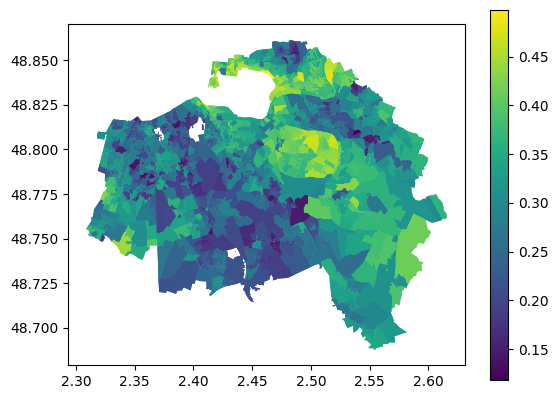

In [176]:
tmp_to_plot[tmp_to_plot.Nuance=='CENTRE-DROIT'].plot(column='% Voix/Exp_nuance', legend=True)


Nuance               EXTGCENTRE-DROITEXTDGCHEECODRTE
% Voix/Exp_nuance                                1.0
dtype: object

In [47]:
#filter on all rows where Code Postalm begins with 94
results_val_de_marne = results[results['Code Postal'].astype(str).str.startswith('94')]
gdf_val_de_marne = gdf[gdf['id_bv'].astype(str).str.startswith('94')]

In [46]:
results[['Election','Tour','Annee']].drop_duplicates()

,Election,Tour,Annee
0,leg,1,2007
736924,leg,2,2007
821854,pres,1,2012
1406084,pres,2,2012
1522930,leg,2,2017
1699858,leg,1,2017
3303037,leg,2,2022
3482500,leg,1,2022
4802764,pres,1,2017
5516393,pres,1,2022


In [48]:
#merge the two dataframes
all_val_de_marne = gdf_val_de_marne.merge(results_val_de_marne, on='id_bv')

In [51]:
#filter for 'Election=pres &  Tour=1'
all_val_de_marne_pres = all_val_de_marne[(all_val_de_marne['Election'] == 'pres') & (all_val_de_marne['Tour'] == 1) & (all_val_de_marne['Annee'] == 2022)]

In [52]:
all_val_de_marne_pres

,id_bv,geometry,Unnamed: 0,Tour,Code du département,Code de la commune,Libellé de la commune,Code du b.vote,Inscrits,Votants,...,Heure d'ouverture,Heure de fermeture,Code Postal,Ville,Nom Bureau Vote,Adresse,Adresse Substitution,Coordonnées,Département,uniq_bdv
94,94001_1,"MULTIPOLYGON (((2.41534 48.72038, 2.41548 48.7...",6278000,1,94,1,Ablon-sur-Seine,1.0,795.0,588.0,...,8.0,20.0,94480.0,Ablon-sur-Seine,Centre Culturel 'Espace Alain Poher',7 avenue Auguste Duru,7 avenue Auguste Duru,"48.724181, 2.420302",94,Centre Culturel 'Espace Alain Poher' - Ablon-...
95,94001_1,"MULTIPOLYGON (((2.41534 48.72038, 2.41548 48.7...",6344363,1,94,1,Ablon-sur-Seine,1.0,795.0,588.0,...,8.0,20.0,94480.0,Ablon-sur-Seine,Centre Culturel 'Espace Alain Poher',7 avenue Auguste Duru,7 avenue Auguste Duru,"48.724181, 2.420302",94,Centre Culturel 'Espace Alain Poher' - Ablon-...
96,94001_1,"MULTIPOLYGON (((2.41534 48.72038, 2.41548 48.7...",6410726,1,94,1,Ablon-sur-Seine,1.0,795.0,588.0,...,8.0,20.0,94480.0,Ablon-sur-Seine,Centre Culturel 'Espace Alain Poher',7 avenue Auguste Duru,7 avenue Auguste Duru,"48.724181, 2.420302",94,Centre Culturel 'Espace Alain Poher' - Ablon-...
97,94001_1,"MULTIPOLYGON (((2.41534 48.72038, 2.41548 48.7...",6477089,1,94,1,Ablon-sur-Seine,1.0,795.0,588.0,...,8.0,20.0,94480.0,Ablon-sur-Seine,Centre Culturel 'Espace Alain Poher',7 avenue Auguste Duru,7 avenue Auguste Duru,"48.724181, 2.420302",94,Centre Culturel 'Espace Alain Poher' - Ablon-...
98,94001_1,"MULTIPOLYGON (((2.41534 48.72038, 2.41548 48.7...",6543452,1,94,1,Ablon-sur-Seine,1.0,795.0,588.0,...,8.0,20.0,94480.0,Ablon-sur-Seine,Centre Culturel 'Espace Alain Poher',7 avenue Auguste Duru,7 avenue Auguste Duru,"48.724181, 2.420302",94,Centre Culturel 'Espace Alain Poher' - Ablon-...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
86403,94081_9,"POLYGON ((2.37655 48.77342, 2.37642 48.77342, ...",6743304,1,94,81,Vitry-sur-Seine,9.0,882.0,643.0,...,8.0,20.0,94400.0,Vitry-sur-Seine,Ecole élémentaire Paul Langevin,Rue Gérard Philippe,Rue Gérard Philippe,"48.774736, 2.377222",94,Ecole élémentaire Paul Langevin - Vitry-sur-S...
86404,94081_9,"POLYGON ((2.37655 48.77342, 2.37642 48.77342, ...",6809667,1,94,81,Vitry-sur-Seine,9.0,882.0,643.0,...,8.0,20.0,94400.0,Vitry-sur-Seine,Ecole élémentaire Paul Langevin,Rue Gérard Philippe,Rue Gérard Philippe,"48.774736, 2.377222",94,Ecole élémentaire Paul Langevin - Vitry-sur-S...
86405,94081_9,"POLYGON ((2.37655 48.77342, 2.37642 48.77342, ...",6876030,1,94,81,Vitry-sur-Seine,9.0,882.0,643.0,...,8.0,20.0,94400.0,Vitry-sur-Seine,Ecole élémentaire Paul Langevin,Rue Gérard Philippe,Rue Gérard Philippe,"48.774736, 2.377222",94,Ecole élémentaire Paul Langevin - Vitry-sur-S...
86406,94081_9,"POLYGON ((2.37655 48.77342, 2.37642 48.77342, ...",6942393,1,94,81,Vitry-sur-Seine,9.0,882.0,643.0,...,8.0,20.0,94400.0,Vitry-sur-Seine,Ecole élémentaire Paul Langevin,Rue Gérard Philippe,Rue Gérard Philippe,"48.774736, 2.377222",94,Ecole élémentaire Paul Langevin - Vitry-sur-S...


In [67]:
all_val_de_marne_pres['% Voix/Exp']=all_val_de_marne_pres['% Voix/Exp'].str.replace(',','.').astype(float)

/Users/joevincentgaltie/pomme/.venv/lib/python3.11/site-packages/geopandas/geodataframe.py:1538: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


In [76]:
all_val_de_marne_pres[['Nuance','Nom']]

,Nuance,Nom
94,EXTG,ARTHAUD
95,EXTG,ROUSSEL
96,CENTRE-DROIT,MACRON
97,CENTRE-DROIT,LASSALLE
98,EXTD,LE PEN
...,...,...
86403,GCHE,HIDALGO
86404,ECO,JADOT
86405,DRTE,PÉCRESSE
86406,EXTG,POUTOU


In [83]:
all_val_de_marne_pres.columns

Index(['id_bv', 'geometry', 'Unnamed: 0', 'Tour', 'Code du département',
       'Code de la commune', 'Libellé de la commune', 'Code du b.vote',
       'Inscrits', 'Votants', 'Exprimés', 'N°Panneau', 'Nom', 'Prénom',
       'Nuance', 'Voix', 'Election', 'Annee', 'Code de la circonscription',
       'Code du canton', 'Libellé du département',
       'Libellé de la circonscription', 'Abstentions', '% Abs/Ins',
       '% Vot/Ins', 'Blancs', '% Blancs/Ins', '% Blancs/Vot', 'Nuls',
       '% Nuls/Ins', '% Nuls/Vot', '% Exp/Ins', '% Exp/Vot', '% Voix/Ins',
       '% Voix/Exp', 'Code INSEE', 'Bureau de vote', 'Code Bureau Vote',
       'Heure d'ouverture', 'Heure de fermeture', 'Code Postal', 'Ville',
       'Nom Bureau Vote', 'Adresse', 'Adresse Substitution', 'Coordonnées',
       'Département', 'uniq_bdv'],
      dtype='object')

In [86]:
#all_val_de_marne_pres plot column '% Voix/Exp' on a map with column 'geometry' as geometry and a color map
#all_val_de_marne_pres.plot(column='% Voix/Exp', legend=True, figsize=(10,10))
#color map
all_val_de_marne_pres[all_val_de_marne_pres.Nom=='MACRON'].explore(column='% Voix/Exp', legend=True, tooltip=False,popup=['Adresse','Nom Bureau Vote','% Abs/Ins'], cmap='OrRd', tiles="CartoDB dark_matter")


In [16]:
def filter_results_file(code_insee : int, base : pd.DataFrame) : 
    return base[base['Code INSEE']==code_insee]

In [24]:
tmp_results = filter_results_file(code_insee=94080, base = results)
tmp_results = pd.merge(tmp_results, gdf, on ='id_bv')

In [60]:
results[results.Election=='pres'].Nom.unique()

array(['JOLY', 'LE PEN', 'SARKOZY', 'MÉLENCHON', 'POUTOU', 'ARTHAUD',
       'CHEMINADE', 'BAYROU', 'DUPONT-AIGNAN', 'HOLLANDE', 'MACRON',
       'HAMON', 'LASSALLE', 'ASSELINEAU', 'FILLON', 'ROUSSEL', 'ZEMMOUR',
       'M\x83LENCHON', 'HIDALGO', 'JADOT', 'P\x83CRESSE'], dtype=object)

In [63]:
tmp_results[(tmp_results.Tour==1 )& (tmp_results.Election=='pres') & (tmp_results.Annee==2012)][['Nom','Nuance']].drop_duplicates()

,Nom,Nuance
16,JOLY,NaN
17,HOLLANDE,NaN
18,DUPONT-AIGNAN,EXTD
19,MÉLENCHON,EXTG
20,POUTOU,EXTG
21,ARTHAUD,EXTG
22,BAYROU,NaN
23,CHEMINADE,EXTD
24,SARKOZY,NaN
25,LE PEN,EXTD


In [48]:
pd.pivot_table((tmp_results[(tmp_results['Tour']==1)].groupby(['Annee','Election','Tour','Nuance'])['Voix'].sum()/tmp_results[ (tmp_results['Tour']==1)].groupby(['Annee','Election','Tour','Nuance'])['Exprimés'].sum()).reset_index(),values=0,columns='Nuance',index=['Election','Annee'])

Nuance            CENTRE  CENTRE-DROIT    DIVERS      DRTE       ECO  \
Election Annee                                                         
leg      2007        NaN      0.124181  0.004174  0.243014  0.036170   
         2017        NaN      0.318641  0.015113       NaN  0.056198   
         2022   0.012411      0.235916  0.003677       NaN  0.019357   
pres     2012        NaN           NaN       NaN       NaN       NaN   
         2017        NaN      0.405656       NaN  0.267334       NaN   
         2022        NaN      0.201653       NaN       NaN  0.092542   

Nuance              EXTD      EXTG     EXTG       GCHE       REG  
Election Annee                                                    
leg      2007   0.011882  0.011723       NaN  0.125006       NaN  
         2017   0.042035  0.045819       NaN       NaN       NaN  
         2022   0.056361  0.110748       NaN  0.000102  0.004469  
pres     2012   0.028408  0.045508  0.002167       NaN       NaN  
         2017   0.039551  0.080020  0.002483  0.089231       NaN  
         2022   0.054368  0.011084  0.003006  0.020177       NaN

In [3]:
df.head()

,code_commune_ref,reconstitution_code_commune,id_brut_bv_reu,id,geo_adresse,geo_type,geo_score,longitude,latitude,api_line,nb_bv_commune,nb_adresses
0,1001,2,01001_1,01001_0045,Rue des Bles d'Or 01400 L'Abergement-Clémenciat,street,0.85,4.926090,46.151757,BANN,1,5
1,1001,1,01001_1,01001_0040_00101,101 Impasse Bellevue 01400 L'Abergement-Clémen...,housenumber,0.91,4.924261,46.134889,BANG,1,1
2,1001,1,01001_1,01001_0175_00106,106 Route des Garaudes 01400 L'Abergement-Clém...,housenumber,0.91,4.923428,46.133930,BANG,1,1
3,1001,1,01001_1,01001_0230_00190,190 Impasse des Lilas 01400 L'Abergement-Cléme...,housenumber,0.91,4.923083,46.146773,BANG,1,2
4,1001,2,01001_1,01001_0175_00192,192 Route des Garaudes 01400 L'Abergement-Clém...,housenumber,0.95,4.923743,46.133608,BANG,1,3


In [41]:
sf=gpd.read_file('../db/carto/bureau-de-vote-insee-reu-openstreetmap.gpkg')
sf.dropna(subset=['bureau'], inplace=True)
sf['Code_commune']=sf.bureau.str.slice(0,5)
sf['Code_bureau']=sf.bureau.str.slice(6,10)
sf.Code_bureau.apply(lambda x : str(x).zfill(3))

254      013
255      001
256      007
257      001
258      015
        ... 
40552    006
40553    001
40554    011
40555    001
40556    002
Name: Code_bureau, Length: 40303, dtype: object

In [25]:
sf_restricted = sf[sf.nom=='Vincennes']

,insee,nom,bureau,block_ids,color,geometry
33645,94080,Vincennes,94080_1,"[1093652,1093653,1093658,1093659,1093762,10936...",#08f72c,"MULTIPOLYGON (((2.43874 48.84454, 2.43875 48.8..."
33646,94080,Vincennes,94080_10,"[1093681,1093796,1093797,1093798,1093799,10938...",#0ff02d,"MULTIPOLYGON (((2.44266 48.84874, 2.44279 48.8..."
33654,94080,Vincennes,94080_11,"[1093804,1093683,1093683,1093683,1093683,10936...",#08f72c,"MULTIPOLYGON (((2.44939 48.84809, 2.44954 48.8..."
33655,94080,Vincennes,94080_12,"[1093683,1093683,1093683,1093683,1093683,10936...",#4cb24c,"MULTIPOLYGON (((2.44789 48.84709, 2.44765 48.8..."
33656,94080,Vincennes,94080_13,"[1093641,1093642,1093679,1093686,1093767,10937...",#45ba47,"MULTIPOLYGON (((2.45122 48.84810, 2.45097 48.8..."
33657,94080,Vincennes,94080_14,"[1093690,1093647,1093647,1093648,1093648,10936...",#3dc242,"MULTIPOLYGON (((2.45069 48.84703, 2.45066 48.8..."
33658,94080,Vincennes,94080_15,"[1093687,1093684,1093684,1093684,1093684,10936...",#36c93d,"MULTIPOLYGON (((2.44823 48.84872, 2.44828 48.8..."
33659,94080,Vincennes,94080_16,"[1093732,1093733,1093745,1093747,1093734,10937...",#2ed139,"MULTIPOLYGON (((2.43734 48.84658, 2.43754 48.8..."
33660,94080,Vincennes,94080_17,"[1093723,1093724,1093731,1093711,1093711,10937...",#26d935,"MULTIPOLYGON (((2.43215 48.84522, 2.43216 48.8..."
33661,94080,Vincennes,94080_18,"[1093726,1093728,1093711,1093711,1093711,10937...",#1fe032,"MULTIPOLYGON (((2.43227 48.84577, 2.43228 48.8..."


In [9]:
def extract_carto_centered (df_carto : pd.DataFrame, ville : str) -> pd.DataFrame() : 
    """
    fonction qui restreint la carte des bureaux de vote à une ville cible

    Args:
        df_carto (_type_): dataframe avec les contours de bureaux de vote obtenus avec gpd.read_file
        ville : nom de la ville sur laquelle centrer le dataframe

    Returns:
        _type_: dataframe avec les contours de bureaux de vote restreint à la ville demandée
    """
    return df_carto.query('nom == ville')


In [10]:
m=folium.Map()
folium.GeoJson(sf_restricted).add_to(m)

In [11]:
all_results=pd.read_csv('../db/results/all_results.csv')

/var/folders/rc/0g2xxgc57fq40kc5jwsm7h_c0000gn/T/ipykernel_79808/2786231382.py:1: DtypeWarning: Columns (2,5,10,11,12,18,19,21,22,24,25,27,28,29,30,31,32,33,34,39,40,41,42,43,45) have mixed types. Specify dtype option on import or set low_memory=False.
  all_results=pd.read_csv('../db/results/all_results.csv')


In [14]:
all_results

,Unnamed: 0,Tour,Code du département,Code de la commune,Libellé de la commune,Code du b.vote,Inscrits,Votants,Exprimés,N°Panneau,...,Heure d'ouverture,Heure de fermeture,Code Postal,Ville,Nom Bureau Vote,Adresse,Adresse Substitution,Coordonnées,Département,uniq_bdv
0,0,1,1.0,1,L'Abergement-Clémenciat,1.0,598.0,353.0,347.0,4.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,1,1.0,1,L'Abergement-Clémenciat,1.0,598.0,353.0,347.0,5.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2,1,1.0,1,L'Abergement-Clémenciat,1.0,598.0,353.0,347.0,10.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,3,1,1.0,1,L'Abergement-Clémenciat,1.0,598.0,353.0,347.0,17.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,4,1,1.0,1,L'Abergement-Clémenciat,1.0,598.0,353.0,347.0,18.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7474688,7474688,2,ZZ,229,Zurich,1,24867.0,11714.0,11438.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7474689,7474689,2,ZZ,231,Taipei,1,1703.0,775.0,743.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7474690,7474690,2,ZZ,233,Nour-Soultan,1,117.0,53.0,50.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7474691,7474691,2,ZZ,234,Monterrey,1,715.0,205.0,202.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [35]:
m

In [174]:
import streamlit as st

In [175]:
st.write('Hello world !')

2023-09-27 19:56:09.218 
  command:

    streamlit run /Users/joevincentgaltie/pomme/.venv/lib/python3.11/site-packages/ipykernel_launcher.py [ARGUMENTS]
